# Clustering

Provo ad usare più feature per vedere se riesco a ottenere dei cluster più significativi

In [8]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_score

# Caricamento del dataset
df = pd.read_csv('../Datasets/atp_tennis.csv')

# Pre-elaborazione
# Rimuovere righe con valori mancanti (se presenti)
df = df.dropna()

Prima di eseguire il clustering, dobbiamo raccogliere le feature dai dati delle partite di tennis, seguendo i seguenti passaggi:

1.	Durata della partita:

    Anche se il tuo dataset non include un campo che indichi la durata della partita, possiamo calcolare una metrica equivalente. Possiamo utilizzare il numero di set giocati o la differenza nei punteggi come indicatore della durata della partita.

2.	Numero di partite giocate (total_games_played):

    Calcoliamo il numero di partite giocate per ogni giocatore. Questo si può ottenere contando il numero di righe in cui il giocatore compare come Player_1 o Player_2 nel dataset.

3.	Punteggi totali (total_points):

    Sommiamo i punteggi di un giocatore da ogni partita. Per esempio, possiamo sommare Pts_1 per il giocatore Player_1 e Pts_2 per Player_2 per ottenere un totale di punti per ogni giocatore.

4.	Numero di tornei a cui un giocatore ha partecipato (n_tournaments):

    Questo può essere calcolato contando i tornei distinti a cui un giocatore ha partecipato. Ad esempio, possiamo ottenere il numero di tornei unici tramite il campo Tournament.

5.	Numero di finali giocate (total_final_matches):

    Per calcolare questo, possiamo filtrare le partite in cui un giocatore ha partecipato alla finale (questo potrebbe richiedere una colonna aggiuntiva per identificare la fase del torneo).

6.	Numero di vittorie (total_wins):

    Il numero di vittorie totali di un giocatore può essere calcolato contando il numero di volte che un giocatore appare come Winner nel dataset.

7.	Superficie di gioco (surface):

    Può essere utile come feature categorica, come nel caso dei calciatori con le superfici di gioco (Hard, Grass, Clay), che può influire sul gioco di un tennista.

In [10]:
import pandas as pd
import numpy as np
from datetime import datetime

# 1. Feature di base
def create_player_stats_dataset(df):
    # Calcolare il numero di partite giocate per ogni giocatore
    total_games_player_1 = df.groupby('Player_1').size()
    total_games_player_2 = df.groupby('Player_2').size()
    total_games = total_games_player_1.add(total_games_player_2, fill_value=0)

    # Vittorie per superficie
    surface_wins = df.groupby(['Winner', 'Surface']).size().unstack(fill_value=0)

    # Numero di tornei
    tournaments_player_1 = df.groupby('Player_1')['Tournament'].nunique()
    tournaments_player_2 = df.groupby('Player_2')['Tournament'].nunique()
    total_tournaments = tournaments_player_1.add(tournaments_player_2, fill_value=0)

    # Finali giocate
    finals_player_1 = df[df['Round'] == 'The Final'].groupby('Player_1').size()
    finals_player_2 = df[df['Round'] == 'The Final'].groupby('Player_2').size()
    total_finals = finals_player_1.add(finals_player_2, fill_value=0)

    # Vittorie totali
    total_wins = df.groupby('Winner').size()

    # Miglior ranking
    best_rank_1 = df.groupby('Player_1')['Rank_1'].min()
    best_rank_2 = df.groupby('Player_2')['Rank_2'].min()
    best_rank = best_rank_1.combine_first(best_rank_2)

    # 2. Feature aggiuntive
    # Vittorie per serie di tornei
    series_wins = df.groupby(['Winner', 'Series']).size().unstack(fill_value=0)

    # Statistiche temporali
    df['Date'] = pd.to_datetime(df['Date'])
    career_span = df.groupby('Winner')['Date'].agg(lambda x: (x.max() - x.min()).days)
    
    df['month'] = df['Date'].dt.month
    seasonal_performance = df.groupby(['Winner', 'month']).size().unstack(fill_value=0)
    seasonal_performance.columns = [f'wins_month_{i}' for i in seasonal_performance.columns]

    # Statistiche sui set
    def extract_sets(score):
        if pd.isna(score):
            return 0
        return len(str(score).split(' '))

    df['sets_played'] = df['Score'].apply(extract_sets)
    avg_sets = df.groupby('Winner')['sets_played'].mean()

    # Vittorie contro Top 10
    def is_top_10_win(row):
        if row['Winner'] == row['Player_1'] and pd.notnull(row['Rank_2']) and row['Rank_2'] <= 10:
            return 1
        elif row['Winner'] == row['Player_2'] and pd.notnull(row['Rank_1']) and row['Rank_1'] <= 10:
            return 1
        return 0

    df['top_10_win'] = df.apply(is_top_10_win, axis=1)
    top_10_wins = df.groupby('Winner')['top_10_win'].sum()

    # Consistenza del ranking
    rank_std_1 = df.groupby('Player_1')['Rank_1'].std()
    rank_std_2 = df.groupby('Player_2')['Rank_2'].std()
    rank_stability = rank_std_1.combine_first(rank_std_2)

    # Vittorie per round
    rounds_wins = df.groupby(['Winner', 'Round']).size().unstack(fill_value=0)

    # Creare il DataFrame finale
    player_stats = pd.DataFrame({
        'total_matches': total_games,
        'total_tournaments': total_tournaments,
        'total_finals': total_finals,
        'total_wins': total_wins,
        'best_rank': best_rank,
        'career_span_days': career_span,
        'avg_sets_per_match': avg_sets,
        'top_10_wins': top_10_wins,
        'ranking_stability': rank_stability
    })

    # Aggiungere le vittorie per superficie
    for surface in surface_wins.columns:
        player_stats[f'wins_{surface.lower()}'] = surface_wins[surface]

    # Aggiungere le vittorie per serie
    for series in series_wins.columns:
        player_stats[f'wins_{series.lower()}'] = series_wins[series]

    # Aggiungere le vittorie per mese
    player_stats = player_stats.join(seasonal_performance, how='left')

    # Aggiungere le vittorie per round
    for round_name in rounds_wins.columns:
        player_stats[f'wins_{round_name.lower().replace(" ", "_")}'] = rounds_wins[round_name]

    # Calcolare percentuali
    player_stats['win_rate'] = player_stats['total_wins'] / player_stats['total_matches']
    player_stats['finals_rate'] = player_stats['total_finals'] / player_stats['total_matches']

    # Pulizia dei dati
    player_stats = player_stats.fillna(0)
    player_stats = player_stats.replace([np.inf, -np.inf], 0)

    return player_stats

# 7. Gestire i valori NaN e Inf
# Pulizia dei dati
player_stats = player_stats.fillna(0)
player_stats = player_stats.replace([np.inf, -np.inf], 0)

# Leggere il dataset
df = pd.read_csv('../Datasets/atp_tennis.csv')

# Creare il dataset con tutte le feature
player_stats = create_player_stats_dataset(df)

# Salvare il dataset
player_stats.to_csv('../Datasets/tennis_player_stats_complete.csv')

# Mostrare informazioni sul dataset creato
print("\nDimensioni del dataset:", player_stats.shape)
print("\nColonne del dataset:")
print(player_stats.columns.tolist())
print("\nPrime righe del dataset:")
print(player_stats.head())
print("\nStatistiche descrittive:")
print(player_stats.describe())

NameError: name 'player_stats' is not defined

Filtriamo i tennisti che hanno vinto almeno una volta in carriera

In [33]:
# Calcolare il numero di tennisti con almeno una vittoria
vincitori = player_stats[player_stats['total_wins'] > 0]
non_vincitori = player_stats[player_stats['total_wins'] == 0]

print(f"Numero di tennisti che hanno vinto almeno una volta: {len(vincitori)}")
print(f"Numero di tennisti che non hanno mai vinto: {len(non_vincitori)}")

# Mostrare la percentuale
totale_tennisti = len(player_stats)
percentuale_vincitori = (len(vincitori) / totale_tennisti) * 100
percentuale_non_vincitori = (len(non_vincitori) / totale_tennisti) * 100

print(f"\nPercentuale vincitori: {percentuale_vincitori:.2f}%")
print(f"Percentuale non vincitori: {percentuale_non_vincitori:.2f}%")

Numero di tennisti che hanno vinto almeno una volta: 1135
Numero di tennisti che non hanno mai vinto: 587

Percentuale vincitori: 65.91%
Percentuale non vincitori: 34.09%


In [34]:
# Filtrare i tennisti che hanno vinto almeno una volta in carriera
vincitori = player_stats[player_stats['total_wins'] > 0].sort_values('total_wins', ascending=False)

print("Statistiche dei tennisti con almeno una vittoria:")
print(vincitori)

# Statistiche aggiuntive sui vincitori
print(f"\nNumero totale di vincitori: {len(vincitori)}")
print("\nStatistiche riassuntive delle vittorie:")
print(vincitori['total_wins'].describe())

Statistiche dei tennisti con almeno una vittoria:
              total_matches  total_tournaments  total_finals  total_wins  \
Federer R.           1393.0              125.0         153.0      1151.0   
Djokovic N.          1211.0              100.0         136.0      1020.0   
Nadal R.             1214.0              123.0         128.0      1007.0   
Ferrer D.            1035.0              172.0          52.0       677.0   
Murray A.             924.0              138.0          67.0       670.0   
...                     ...                ...           ...         ...   
Fraile G.               9.0                8.0           0.0         1.0   
Friedl L.               5.0                5.0           0.0         1.0   
Froberg J.              2.0                1.0           0.0         1.0   
Rieschick S.            4.0                4.0           0.0         1.0   
 Hajek J.               2.0                1.0           0.0         1.0   

              best_rank  career_span_

## Visualizzazione dei dati tramite distribuzioni e grafici

### Come sono distribuite le vittorie tra i giocatori?

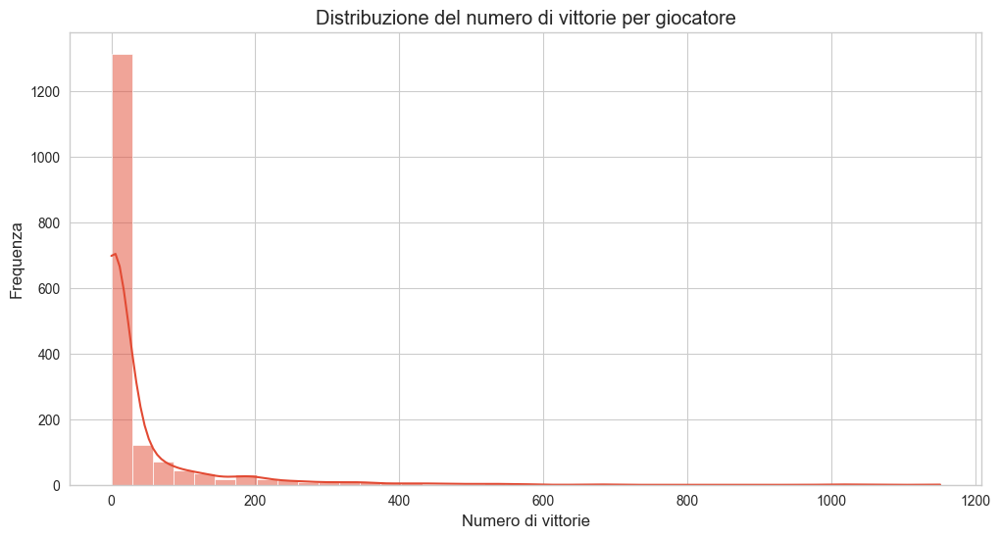

In [35]:
# TUTTI I GIOCATORI

# 1. Distribuzione del numero di vittorie
plt.figure(figsize=(12, 6))
sns.set_style('whitegrid')
sns.histplot(data=player_stats['total_wins'], kde=True, bins=40)
plt.title('Distribuzione del numero di vittorie per giocatore')
plt.xlabel('Numero di vittorie')
plt.ylabel('Frequenza')
plt.show()

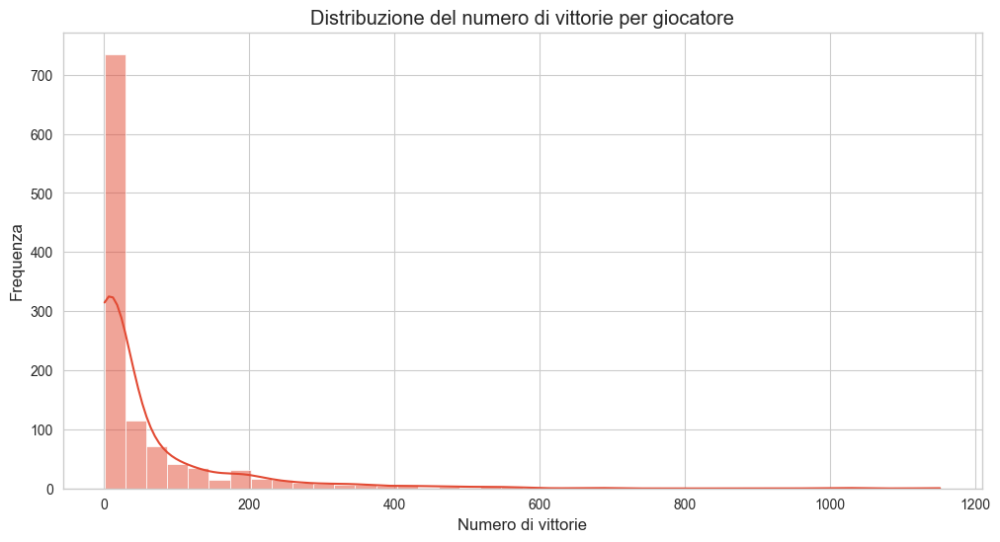

In [36]:
# VINCITORI

# 1. Distribuzione del numero di vittorie
plt.figure(figsize=(12, 6))
sns.set_style('whitegrid')
sns.histplot(data=vincitori['total_wins'], kde=True, bins=40)
plt.title('Distribuzione del numero di vittorie per giocatore')
plt.xlabel('Numero di vittorie')
plt.ylabel('Frequenza')
plt.show()

### La relazione tra ranking e vittorie

<Figure size 1800x1200 with 0 Axes>

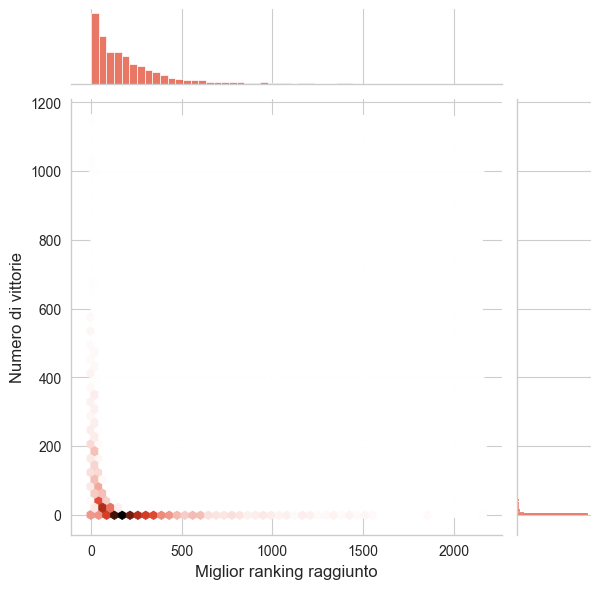

<Figure size 1800x1200 with 0 Axes>

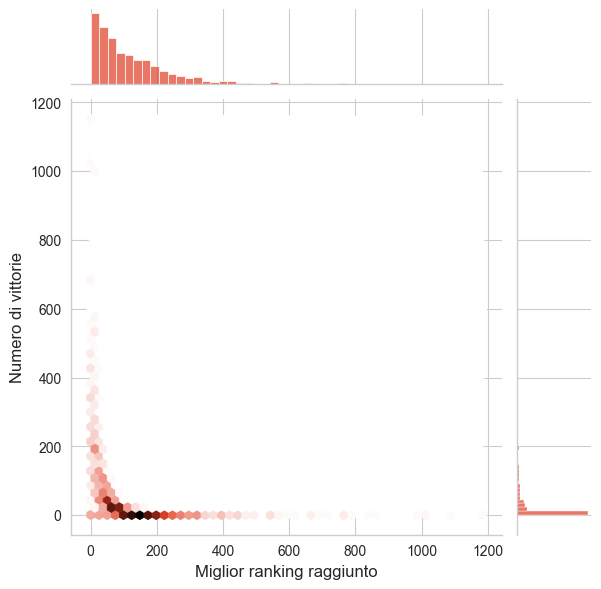

In [37]:
# TUTTI I GIOCATORI

# 2. Relazione tra vittorie e ranking migliore
plt.figure(figsize=(18, 12))
sns.set_style('whitegrid')
sns.jointplot(data=player_stats, x='best_rank', y='total_wins', kind='hex')
plt.xlabel('Miglior ranking raggiunto')
plt.ylabel('Numero di vittorie')
plt.show()

# VINCITORI

# 2. Relazione tra vittorie e ranking migliore
plt.figure(figsize=(18, 12))
sns.set_style('whitegrid')
sns.jointplot(data=vincitori, x='best_rank', y='total_wins', kind='hex')
plt.xlabel('Miglior ranking raggiunto')
plt.ylabel('Numero di vittorie')
plt.show()

### Come si distribuiscono le vittorie sulle diverse superfici

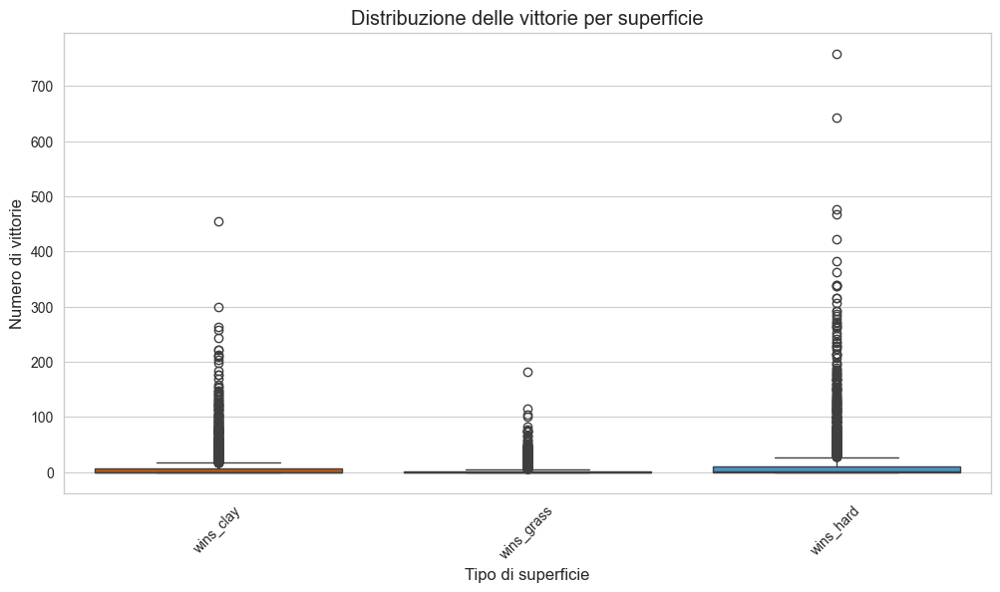

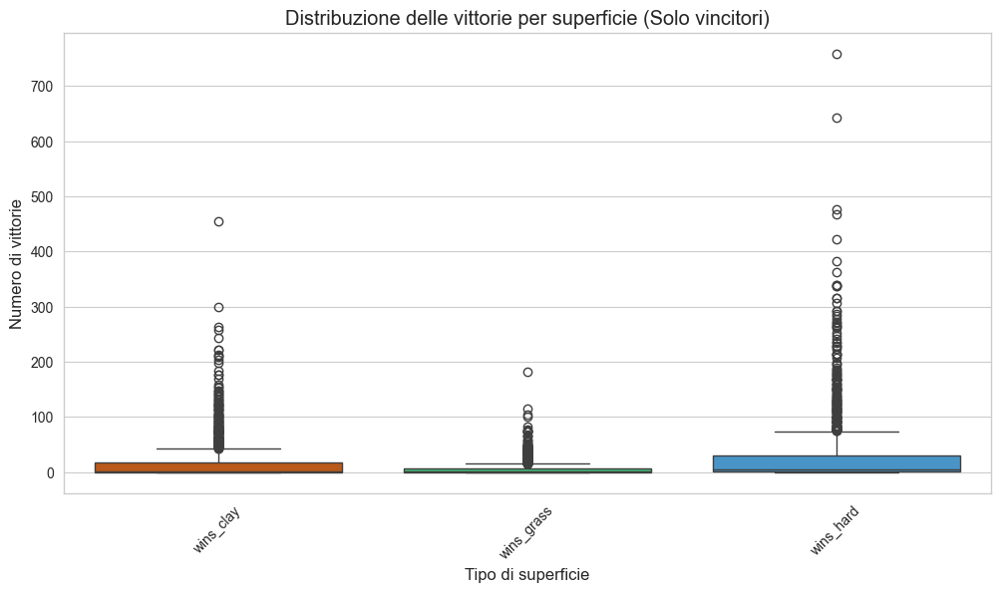

In [40]:
import matplotlib.pyplot as plt
import seaborn as sns

# Seleziona solo le colonne delle tre superfici principali
surface_columns = ['wins_clay', 'wins_grass', 'wins_hard']
surface_data = player_stats[surface_columns]

plt.figure(figsize=(12, 6))
sns.set_style('whitegrid')

# Definiamo i colori per ogni superficie
colors = {
    'wins_grass': '#2ecc71',    # verde
    'wins_hard': '#3498db',     # blu
    'wins_clay': '#d35400'      # arancio scuro
}

# Creiamo il boxplot con i colori personalizzati
sns.boxplot(data=surface_data, palette=colors)

plt.title('Distribuzione delle vittorie per superficie')
plt.xlabel('Tipo di superficie')
plt.ylabel('Numero di vittorie')
plt.xticks(rotation=45)
plt.show()

# Per i vincitori
surface_data_vincitori = vincitori[surface_columns]

plt.figure(figsize=(12, 6))
sns.set_style('whitegrid')

# Creiamo il boxplot con gli stessi colori
sns.boxplot(data=surface_data_vincitori, palette=colors)

plt.title('Distribuzione delle vittorie per superficie (Solo vincitori)')
plt.xlabel('Tipo di superficie')
plt.ylabel('Numero di vittorie')
plt.xticks(rotation=45)
plt.show()

### Chi sono i giocatori più attivi?


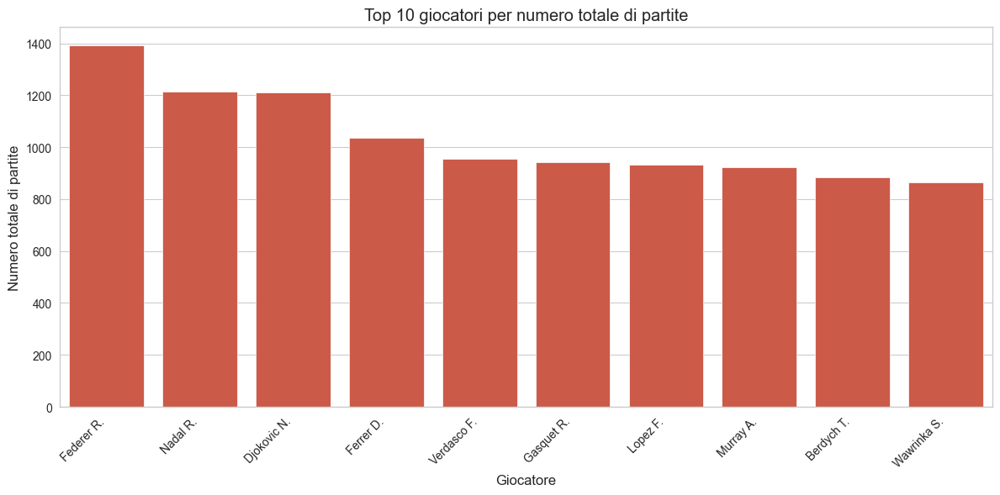

In [41]:
# 4. Top 10 giocatori per numero totale di partite
plt.figure(figsize=(12, 6))
sns.set_style('whitegrid')
top_10_matches = vincitori.nlargest(10, 'total_matches')
sns.barplot(data=top_10_matches, x=top_10_matches.index, y='total_matches')
plt.title('Top 10 giocatori per numero totale di partite')
plt.xlabel('Giocatore')
plt.ylabel('Numero totale di partite')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

## Come sono correlate le diverse statistiche tra loro?

La matrice di correlazione è uno strumento molto utile per capire come le variabili del tuo dataset siano collegate tra loro. Essa mostra quanto due variabili siano correlate tra loro: se il valore della correlazione è vicino a 1, significa che c’è una forte correlazione positiva, se è vicino a -1, c’è una forte correlazione negativa, mentre un valore vicino a 0 indica che non c’è correlazione.

Passaggi per calcolare e visualizzare la matrice di correlazione:

1.	Calcolare la matrice di correlazione: Usiamo la funzione .corr() di Pandas, che calcola la correlazione tra le variabili numeriche nel DataFrame.
    
2.	Visualizzare la matrice di correlazione: Usiamo una heatmap per visualizzare la matrice, che rende più facile interpretare i valori di correlazione.

In [42]:
# sns.pairplot(): È una funzione di Seaborn che genera un pairplot, ovvero una matrice di grafici a dispersione tra tutte le coppie di colonne del DataFrame. 
# Inoltre, genera anche istogrammi lungo la diagonale per mostrare la distribuzione di ciascuna variabile.

# SOLAMENTE PER I VINCITORI

sns.pairplot(vincitori)
plt.show()

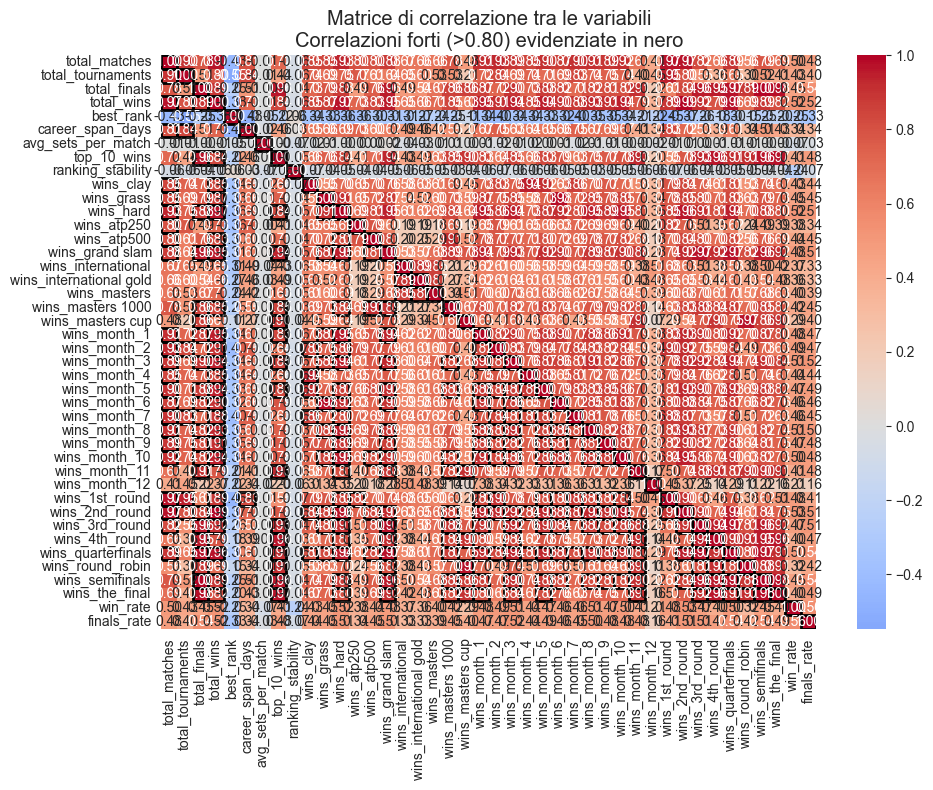

Numero totale di correlazioni possibili: 861

Numero di correlazioni forti (>0.80): 308
Percentuale di correlazioni forti: 35.77%

Correlazioni forti (>0.80):
total_matches - total_matches: 1.00
total_tournaments - total_matches: 0.90
total_tournaments - total_tournaments: 1.00
total_finals - total_finals: 1.00
total_wins - total_matches: 0.97
total_wins - total_tournaments: 0.80
total_wins - total_finals: 0.89
total_wins - total_wins: 1.00
best_rank - best_rank: 1.00
career_span_days - total_matches: 0.81
career_span_days - total_tournaments: 0.84
career_span_days - career_span_days: 1.00
avg_sets_per_match - avg_sets_per_match: 1.00
top_10_wins - total_finals: 0.96
top_10_wins - total_wins: 0.84
top_10_wins - top_10_wins: 1.00
ranking_stability - ranking_stability: 1.00
wins_clay - total_matches: 0.85
wins_clay - total_wins: 0.85
wins_clay - wins_clay: 1.00
wins_grass - total_matches: 0.85
wins_grass - total_wins: 0.87
wins_grass - wins_grass: 1.00
wins_hard - total_matches: 0.93
win

In [43]:
plt.figure(figsize=(10, 8))

# Calcoliamo la matrice di correlazione
correlation_matrix = vincitori.select_dtypes(include=['float64', 'int64']).corr()

# Creiamo una maschera per il triangolo superiore
mask_upper = np.triu(np.ones_like(correlation_matrix), k=1)

# Creiamo una maschera per le correlazioni forti
mask_strong = np.abs(correlation_matrix.values) > 0.8
mask_strong[mask_upper.astype(bool)] = False

# Visualizziamo la matrice di correlazione
sns.heatmap(correlation_matrix, 
            annot=True, 
            cmap='coolwarm', 
            fmt='.2f', 
            center=0)

# Evidenziamo le correlazioni forti
for i in range(len(correlation_matrix)):
    for j in range(len(correlation_matrix)):
        if mask_strong[i, j]:
            plt.gca().add_patch(plt.Rectangle((j, i), 1, 1, fill=False, edgecolor='black', lw=2))

plt.title('Matrice di correlazione tra le variabili\nCorrelazioni forti (>0.80) evidenziate in nero')
plt.tight_layout()
plt.show()

# Contiamo il numero di correlazioni forti e totali
n_strong_correlations = np.sum(mask_strong)
n_total_correlations = (len(correlation_matrix) * (len(correlation_matrix) - 1)) // 2  # solo triangolo inferiore

print(f"Numero totale di correlazioni possibili: {n_total_correlations}")
print(f"\nNumero di correlazioni forti (>0.80): {n_strong_correlations}")
print(f"Percentuale di correlazioni forti: {(n_strong_correlations/n_total_correlations)*100:.2f}%")

print("\nCorrelazioni forti (>0.80):")
for i in range(len(correlation_matrix)):
    for j in range(len(correlation_matrix)):
        if mask_strong[i, j]:
            print(f"{correlation_matrix.index[i]} - {correlation_matrix.columns[j]}: {correlation_matrix.iloc[i, j]:.2f}")

In [44]:
# PER TUTTI I GIOCATORI

sns.pairplot(player_stats)
plt.show()

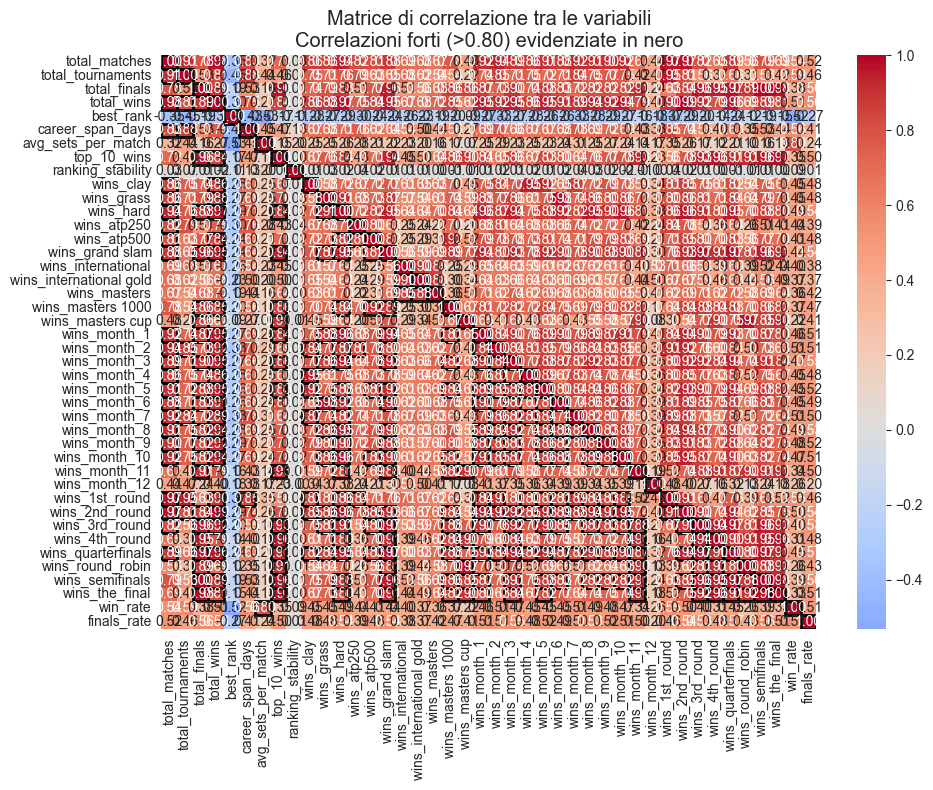

Numero totale di correlazioni possibili: 861

Numero di correlazioni forti (>0.80): 319
Percentuale di correlazioni forti: 37.05%

Correlazioni forti (>0.80):
total_matches - total_matches: 1.00
total_tournaments - total_matches: 0.91
total_tournaments - total_tournaments: 1.00
total_finals - total_finals: 1.00
total_wins - total_matches: 0.98
total_wins - total_tournaments: 0.81
total_wins - total_finals: 0.89
total_wins - total_wins: 1.00
best_rank - best_rank: 1.00
career_span_days - total_matches: 0.83
career_span_days - total_tournaments: 0.88
career_span_days - career_span_days: 1.00
avg_sets_per_match - avg_sets_per_match: 1.00
top_10_wins - total_finals: 0.96
top_10_wins - total_wins: 0.84
top_10_wins - top_10_wins: 1.00
ranking_stability - ranking_stability: 1.00
wins_clay - total_matches: 0.86
wins_clay - total_wins: 0.86
wins_clay - wins_clay: 1.00
wins_grass - total_matches: 0.86
wins_grass - total_wins: 0.88
wins_grass - wins_grass: 1.00
wins_hard - total_matches: 0.94
win

In [46]:
plt.figure(figsize=(10, 8))

# Calcoliamo la matrice di correlazione
correlation_matrix = player_stats.select_dtypes(include=['float64', 'int64']).corr()

# Creiamo una maschera per il triangolo superiore
mask_upper = np.triu(np.ones_like(correlation_matrix), k=1)

# Creiamo una maschera per le correlazioni forti
mask_strong = np.abs(correlation_matrix.values) > 0.8
mask_strong[mask_upper.astype(bool)] = False

# Visualizziamo la matrice di correlazione
sns.heatmap(correlation_matrix, 
            annot=True, 
            cmap='coolwarm', 
            fmt='.2f', 
            center=0)

# Evidenziamo le correlazioni forti
for i in range(len(correlation_matrix)):
    for j in range(len(correlation_matrix)):
        if mask_strong[i, j]:
            plt.gca().add_patch(plt.Rectangle((j, i), 1, 1, fill=False, edgecolor='black', lw=2))

plt.title('Matrice di correlazione tra le variabili\nCorrelazioni forti (>0.80) evidenziate in nero')
plt.tight_layout()
plt.show()

# Contiamo il numero di correlazioni forti e totali
n_strong_correlations = np.sum(mask_strong)
n_total_correlations = (len(correlation_matrix) * (len(correlation_matrix) - 1)) // 2  # solo triangolo inferiore

print(f"Numero totale di correlazioni possibili: {n_total_correlations}")
print(f"\nNumero di correlazioni forti (>0.80): {n_strong_correlations}")
print(f"Percentuale di correlazioni forti: {(n_strong_correlations/n_total_correlations)*100:.2f}%")

print("\nCorrelazioni forti (>0.80):")
for i in range(len(correlation_matrix)):
    for j in range(len(correlation_matrix)):
        if mask_strong[i, j]:
            print(f"{correlation_matrix.index[i]} - {correlation_matrix.columns[j]}: {correlation_matrix.iloc[i, j]:.2f}")

La PCA (Principal Component Analysis) è una tecnica di riduzione della dimensionalità che consente di ridurre il numero di variabili, mantenendo la maggior parte dell’informazione (varianza) del dataset originale. PCA trova delle combinazioni lineari delle variabili originali chiamate componenti principali che spiegano la maggior parte della varianza nel dataset.

Quando hai un dataset con molte feature correlate, come nel tuo caso, la PCA ti permette di ridurre il numero di variabili senza perdere informazioni cruciali, migliorando l’efficienza computazionale e la comprensibilità del modello.

Passaggi per applicare PCA:

1.	Preparare i dati: È importante normalizzare i dati prima di applicare la PCA, poiché PCA è sensibile alla scala delle variabili.

2.	Applicare PCA: Usare PCA di Scikit-learn per ridurre il numero di componenti.

3.	Scegliere il numero di componenti: Decidere quante componenti principali mantenere. Generalmente si mantiene abbastanza componenti per spiegare una percentuale significativa della varianza (ad esempio, l’80% della varianza).

Codice per applicare la PCA:

1.	Normalizzazione dei Dati: Prima di applicare PCA, bisogna normalizzare i dati (ridurre i valori a una scala comune).

2.	Applicazione della PCA: Dopo aver normalizzato i dati, possiamo applicare la PCA e ridurre il numero di componenti.

Colonne disponibili nel dataset:
['total_matches', 'total_tournaments', 'total_finals', 'total_wins', 'best_rank', 'career_span_days', 'avg_sets_per_match', 'top_10_wins', 'ranking_stability', 'wins_clay', 'wins_grass', 'wins_hard', 'wins_atp250', 'wins_atp500', 'wins_grand slam', 'wins_international', 'wins_international gold', 'wins_masters', 'wins_masters 1000', 'wins_masters cup', 'wins_month_1', 'wins_month_2', 'wins_month_3', 'wins_month_4', 'wins_month_5', 'wins_month_6', 'wins_month_7', 'wins_month_8', 'wins_month_9', 'wins_month_10', 'wins_month_11', 'wins_month_12', 'wins_1st_round', 'wins_2nd_round', 'wins_3rd_round', 'wins_4th_round', 'wins_quarterfinals', 'wins_round_robin', 'wins_semifinals', 'wins_the_final', 'win_rate', 'finals_rate']


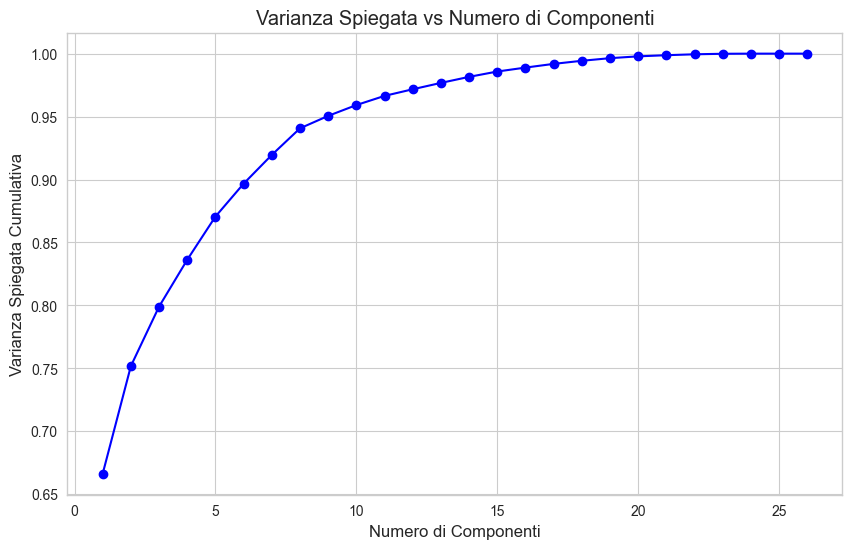


Varianza spiegata da ogni componente:
Componente 1: 0.666 (66.6%)
Componente 2: 0.085 (8.5%)
Componente 3: 0.047 (4.7%)
Componente 4: 0.037 (3.7%)
Componente 5: 0.034 (3.4%)
Componente 6: 0.026 (2.6%)
Componente 7: 0.023 (2.3%)
Componente 8: 0.021 (2.1%)
Componente 9: 0.010 (1.0%)
Componente 10: 0.009 (0.9%)
Componente 11: 0.007 (0.7%)
Componente 12: 0.005 (0.5%)
Componente 13: 0.005 (0.5%)
Componente 14: 0.005 (0.5%)
Componente 15: 0.004 (0.4%)
Componente 16: 0.003 (0.3%)
Componente 17: 0.003 (0.3%)
Componente 18: 0.002 (0.2%)
Componente 19: 0.002 (0.2%)
Componente 20: 0.001 (0.1%)
Componente 21: 0.001 (0.1%)
Componente 22: 0.001 (0.1%)
Componente 23: 0.000 (0.0%)
Componente 24: 0.000 (0.0%)
Componente 25: 0.000 (0.0%)
Componente 26: 0.000 (0.0%)

Matrice dei componenti principali:
      total_matches  total_tournaments  total_finals  total_wins  \
PC1    2.346274e-01       2.010821e-01  2.127221e-01    0.238956   
PC2    4.399288e-02       2.428106e-01 -2.121396e-01   -0.050117   
P

In [49]:
# Preparazione dei dati per PCA
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Prima stampiamo le colonne disponibili
print("Colonne disponibili nel dataset:")
print(player_stats.columns.tolist())

# Poi definiamo features_for_pca usando solo le colonne esistenti
features_for_pca = [
    # Feature di base
    'total_matches',
    'total_tournaments',
    'total_finals',
    'total_wins',
    'best_rank',
    'career_span_days',
    'avg_sets_per_match',
    'top_10_wins',
    'ranking_stability',
    
    # Vittorie per superficie
    'wins_clay',
    'wins_grass',
    'wins_hard',
    
    # Vittorie per mese
    'wins_month_1',
    'wins_month_2',
    'wins_month_3',
    'wins_month_4',
    'wins_month_5',
    'wins_month_6',
    'wins_month_7',
    'wins_month_8',
    'wins_month_9',
    'wins_month_10',
    'wins_month_11',
    'wins_month_12',
    
    # Percentuali
    'win_rate',
    'finals_rate'
]

# Verifichiamo che tutte le feature selezionate esistano
features_for_pca = [f for f in features_for_pca if f in player_stats.columns]

# Caricamento e preparazione dei dati
df = pd.read_csv('../Datasets/tennis_player_stats_complete.csv')
X = df[features_for_pca]

# Standardizzazione dei dati
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Applicazione PCA
pca = PCA()
X_pca = pca.fit_transform(X_scaled)

# Visualizzazione della varianza spiegata
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(pca.explained_variance_ratio_) + 1), 
         np.cumsum(pca.explained_variance_ratio_), 'bo-')
plt.xlabel('Numero di Componenti')
plt.ylabel('Varianza Spiegata Cumulativa')
plt.title('Varianza Spiegata vs Numero di Componenti')
plt.grid(True)
plt.show()

# Stampa della varianza spiegata
print("\nVarianza spiegata da ogni componente:")
for i, var in enumerate(pca.explained_variance_ratio_):
    print(f"Componente {i+1}: {var:.3f} ({var*100:.1f}%)")

# Matrice dei componenti
componenti_df = pd.DataFrame(
    pca.components_,
    columns=features_for_pca,
    index=[f'PC{i+1}' for i in range(len(pca.components_))]
)

print("\nMatrice dei componenti principali:")
print(componenti_df)

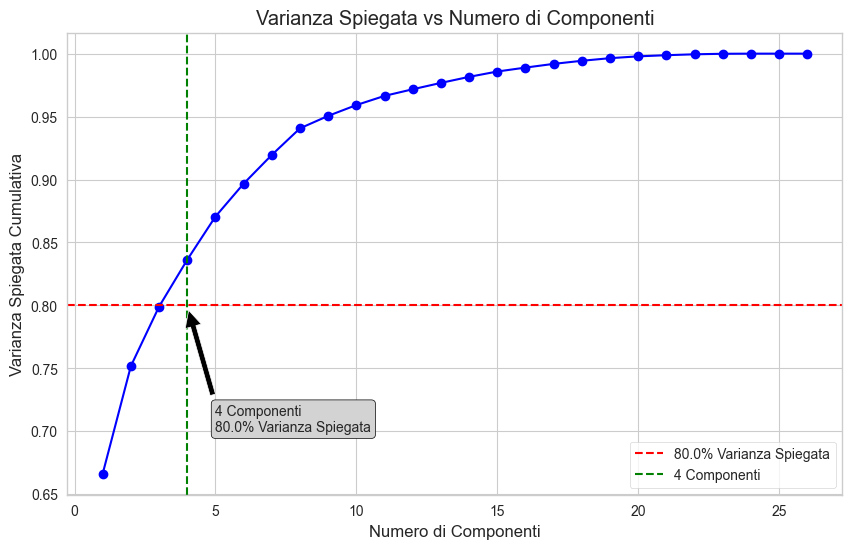

In [50]:
# 3. Visualizzazione della varianza spiegata
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(pca.explained_variance_ratio_) + 1), 
         np.cumsum(pca.explained_variance_ratio_), 'bo-')
plt.xlabel('Numero di Componenti')
plt.ylabel('Varianza Spiegata Cumulativa')
plt.title('Varianza Spiegata vs Numero di Componenti')
plt.grid(True)

# Annotazione per il punto di scelta delle componenti
threshold = 0.8  # Soglia di varianza spiegata (80%)
num_components = np.argmax(np.cumsum(pca.explained_variance_ratio_) >= threshold) + 1

plt.axhline(y=threshold, color='r', linestyle='--', label=f'{threshold*100}% Varianza Spiegata')
plt.axvline(x=num_components, color='g', linestyle='--', label=f'{num_components} Componenti')

plt.annotate(f'{num_components} Componenti\n{threshold*100}% Varianza Spiegata', 
             xy=(num_components, threshold), 
             xytext=(num_components+1, threshold-0.1),
             arrowprops=dict(facecolor='black', shrink=0.05),
             fontsize=10, 
             bbox=dict(boxstyle="round,pad=0.3", edgecolor='black', facecolor='lightgray'))

plt.legend()
plt.show()

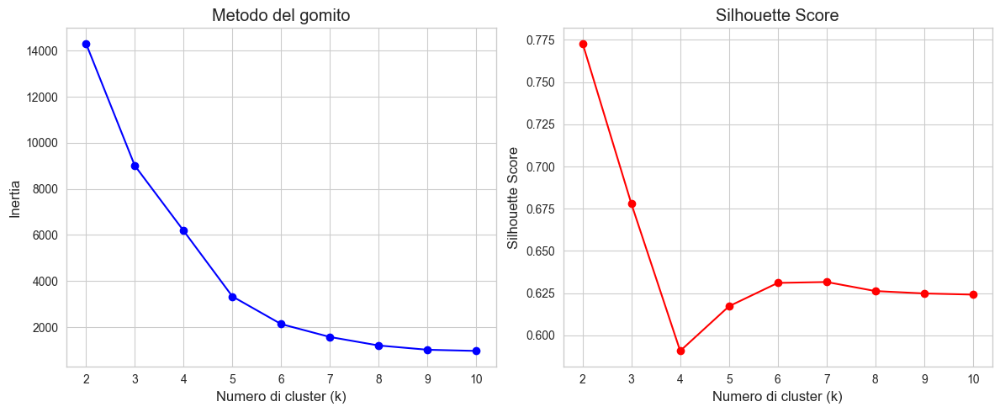

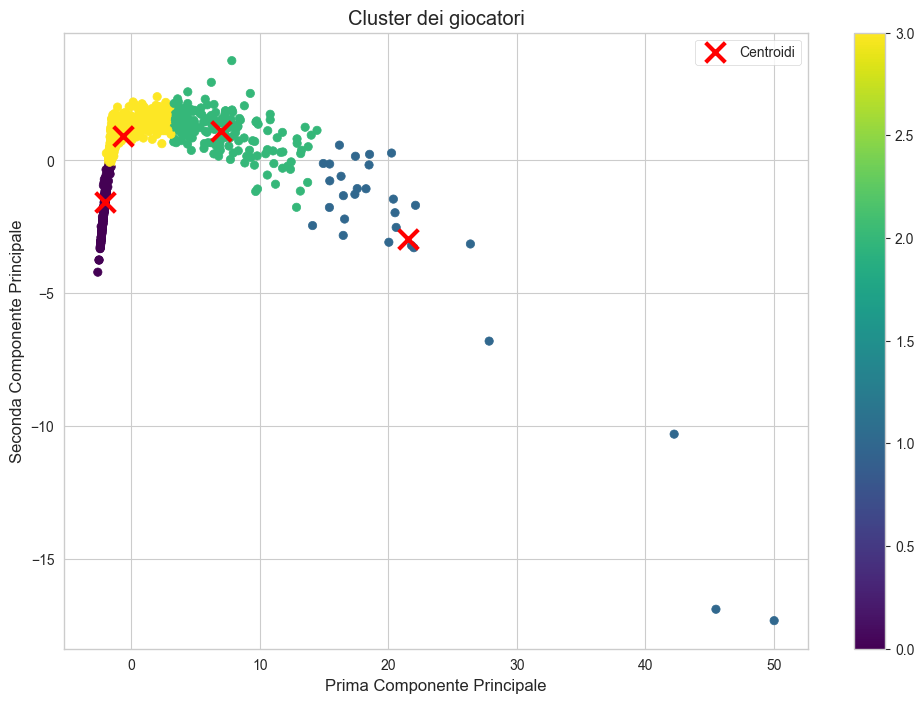


Statistiche per cluster:

Cluster 0:
Numero di giocatori: 608

Esempi di giocatori in questo cluster:
        Unnamed: 0  total_matches  total_tournaments  total_finals  \
1       Abdulla M.            1.0                1.0           0.0   
4    Adaktusson J.            1.0                1.0           0.0   
5         Agaev E.            1.0                1.0           0.0   
9          Ager J.            2.0                2.0           0.0   
10  Agostinelli B.            1.0                1.0           0.0   

    total_wins  best_rank  career_span_days  avg_sets_per_match  top_10_wins  \
1          0.0     1349.0               0.0                 0.0          0.0   
4          0.0      265.0               0.0                 0.0          0.0   
5          0.0      368.0               0.0                 0.0          0.0   
9          0.0      295.0               0.0                 0.0          0.0   
10         0.0     1171.0               0.0                 0.0          0.0

In [51]:
# Questo lo fa geppetto

from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt
import seaborn as sns

# 1. Determiniamo il numero ottimale di cluster usando il metodo del gomito
inertias = []
silhouette_scores = []
k_range = range(2, 11)

for k in k_range:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(X_pca[:, :2])  # Usiamo solo le prime 2 componenti principali
    inertias.append(kmeans.inertia_)
    silhouette_scores.append(silhouette_score(X_pca[:, :2], kmeans.labels_))

# Visualizziamo il grafico del gomito
plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
plt.plot(k_range, inertias, 'bo-')
plt.xlabel('Numero di cluster (k)')
plt.ylabel('Inertia')
plt.title('Metodo del gomito')

plt.subplot(1, 2, 2)
plt.plot(k_range, silhouette_scores, 'ro-')
plt.xlabel('Numero di cluster (k)')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Score')

plt.tight_layout()
plt.show()

# 2. Applichiamo K-means con il numero ottimale di cluster (esempio con k=4)
n_clusters = 4  # Modifica questo valore in base ai risultati del metodo del gomito
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
cluster_labels = kmeans.fit_predict(X_pca[:, :2])

# 3. Visualizziamo i cluster
plt.figure(figsize=(12, 8))
scatter = plt.scatter(X_pca[:, 0], X_pca[:, 1], c=cluster_labels, cmap='viridis')
plt.xlabel('Prima Componente Principale')
plt.ylabel('Seconda Componente Principale')
plt.title('Cluster dei giocatori')
plt.colorbar(scatter)

# Aggiungiamo i centroidi
centroids = kmeans.cluster_centers_
plt.scatter(centroids[:, 0], centroids[:, 1], marker='x', s=200, linewidths=3, color='r', label='Centroidi')
plt.legend()
plt.show()

# 4. Analizziamo i cluster
df_results = pd.DataFrame({
    'Giocatore': df.index,
    'Cluster': cluster_labels,
    'PC1': X_pca[:, 0],
    'PC2': X_pca[:, 1]
})

# Stampiamo le statistiche per ogni cluster
print("\nStatistiche per cluster:")
for i in range(n_clusters):
    print(f"\nCluster {i}:")
    cluster_indices = df_results[df_results['Cluster'] == i].index
    print(f"Numero di giocatori: {len(cluster_indices)}")
    print("\nEsempi di giocatori in questo cluster:")
    print(df.iloc[cluster_indices].head())

In [60]:
# Ma analizziamo meglio PER I VINCITORI

print("Iniziando l'analisi PCA e clustering...")

# 1. Preparazione dei dati
print("\n1. Selezione e preparazione dei dati...")
features_for_pca = player_stats.select_dtypes(include=[np.number]).columns
X = player_stats[features_for_pca]
print(features_for_pca)

Iniziando l'analisi PCA e clustering...

1. Selezione e preparazione dei dati...
Index(['total_matches', 'total_tournaments', 'total_finals', 'total_wins',
       'best_rank', 'career_span_days', 'avg_sets_per_match', 'top_10_wins',
       'ranking_stability', 'wins_clay', 'wins_grass', 'wins_hard',
       'wins_atp250', 'wins_atp500', 'wins_grand slam', 'wins_international',
       'wins_international gold', 'wins_masters', 'wins_masters 1000',
       'wins_masters cup', 'wins_month_1', 'wins_month_2', 'wins_month_3',
       'wins_month_4', 'wins_month_5', 'wins_month_6', 'wins_month_7',
       'wins_month_8', 'wins_month_9', 'wins_month_10', 'wins_month_11',
       'wins_month_12', 'wins_1st_round', 'wins_2nd_round', 'wins_3rd_round',
       'wins_4th_round', 'wins_quarterfinals', 'wins_round_robin',
       'wins_semifinals', 'wins_the_final', 'win_rate', 'finals_rate'],
      dtype='object')


In [61]:
# 2. Normalizzazione
print("2. Normalizzazione dei dati...")
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
print("✓ Dati normalizzati")

2. Normalizzazione dei dati...
✓ Dati normalizzati


In [62]:
# 3. Applicazione PCA
print("\n3. Applicazione PCA...")
pca = PCA(n_components=0.8)  # mantiene l'80% della varianza
X_pca = pca.fit_transform(X_scaled)
print(f"✓ PCA applicata - Numero di componenti selezionate: {pca.n_components_}")


3. Applicazione PCA...
✓ PCA applicata - Numero di componenti selezionate: 3


In [63]:
from tqdm import tqdm  # Aggiungiamo questo import

# 4. Determinazione numero ottimale di cluster
print("\n4. Calcolo del numero ottimale di cluster...")
wcss = []
k_range = range(1, 11)

# Calcolo WCSS per ogni k
for k in tqdm(k_range, desc="Calcolo WCSS"):
    kmeans = KMeans(n_clusters=k, init='k-means++', max_iter=300, n_init=10, random_state=42)
    kmeans.fit(X_pca)
    wcss.append(kmeans.inertia_)


4. Calcolo del numero ottimale di cluster...


Calcolo WCSS: 100%|██████████| 10/10 [00:00<00:00, 33.30it/s]



Calcolo metriche per diversi valori di k...


Analisi cluster: 100%|██████████| 9/9 [00:00<00:00, 16.83it/s]


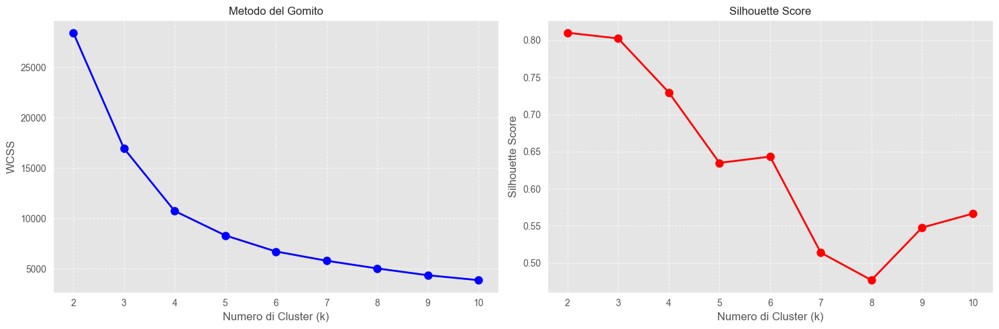


Analisi dettagliata:
k	WCSS		Silhouette	Riduzione WCSS
2	28451		0.810		N/A
3	16965		0.802		40.37%
4	10744		0.730		36.67%
5	8314		0.635		22.61%
6	6715		0.643		19.23%
7	5796		0.514		13.68%
8	5029		0.477		13.24%
9	4352		0.548		13.47%
10	3867		0.566		11.14%


In [64]:
# Calcoliamo sia WCSS che Silhouette Score
wcss = []
silhouette_scores = []
k_range = range(2, 11)  # Partiamo da 2 perché silhouette score richiede almeno 2 cluster

print("\nCalcolo metriche per diversi valori di k...")
for k in tqdm(k_range, desc="Analisi cluster"):
    kmeans = KMeans(n_clusters=k, init='k-means++', max_iter=300, n_init=10, random_state=42)
    kmeans.fit(X_pca)
    wcss.append(kmeans.inertia_)
    silhouette_scores.append(silhouette_score(X_pca, kmeans.labels_))

# Visualizziamo entrambe le metriche
plt.figure(figsize=(15, 5))

# Grafico del gomito
plt.subplot(1, 2, 1)
plt.plot(k_range, wcss, 'bo-', linewidth=2, markersize=8)
plt.title('Metodo del Gomito', fontsize=12)
plt.xlabel('Numero di Cluster (k)')
plt.ylabel('WCSS')
plt.grid(True, linestyle='--', alpha=0.7)

# Grafico Silhouette Score
plt.subplot(1, 2, 2)
plt.plot(k_range, silhouette_scores, 'ro-', linewidth=2, markersize=8)
plt.title('Silhouette Score', fontsize=12)
plt.xlabel('Numero di Cluster (k)')
plt.ylabel('Silhouette Score')
plt.grid(True, linestyle='--', alpha=0.7)

plt.tight_layout()
plt.show()

# Stampiamo i valori
print("\nAnalisi dettagliata:")
print("k\tWCSS\t\tSilhouette\tRiduzione WCSS")
for i, k in enumerate(k_range):
    if i == 0:
        reduction = "N/A"
    else:
        reduction = f"{((wcss[i-1] - wcss[i]) / wcss[i-1] * 100):.2f}%"
    print(f"{k}\t{wcss[i]:.0f}\t\t{silhouette_scores[i]:.3f}\t\t{reduction}")

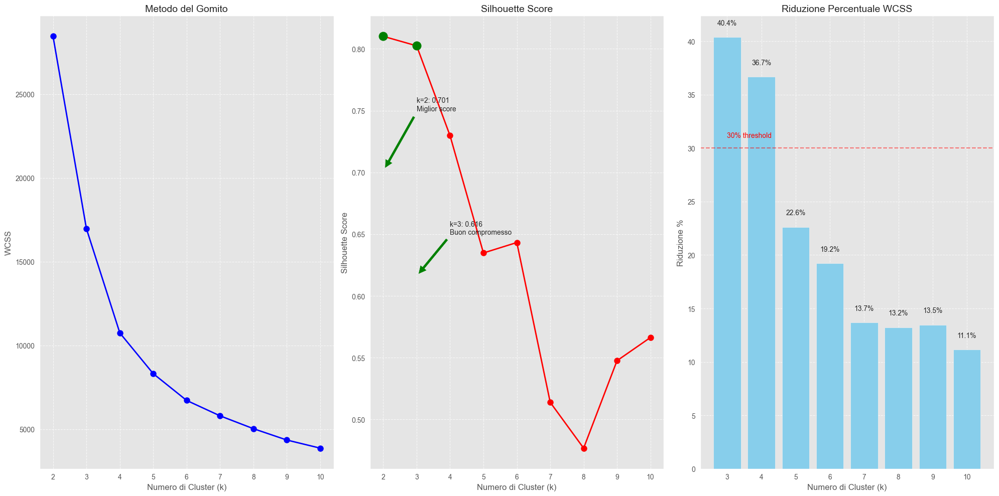


Riepilogo Analisi:
------------------
1. Silhouette Score:
   - Massimo: 0.701 (k=2)
   - k=3: 0.616 (buon compromesso)

2. Riduzioni WCSS significative:
   - k=2→3: 38.71%
   - k=4→5: 35.76%

3. Conclusione:
   k=3 offre il miglior compromesso tra:
   - Qualità dei cluster (Silhouette > 0.6)
   - Riduzione significativa del WCSS
   - Complessità interpretabile


In [65]:
# Visualizzazione dettagliata delle metriche
plt.figure(figsize=(20, 10))

# 1. Grafico del gomito con annotazioni
plt.subplot(1, 3, 1)
plt.plot(k_range, wcss, 'bo-', linewidth=2, markersize=8)
plt.title('Metodo del Gomito', fontsize=14)
plt.xlabel('Numero di Cluster (k)')
plt.ylabel('WCSS')
plt.grid(True, linestyle='--', alpha=0.7)

# Aggiungiamo freccia e annotazione per k=3
plt.annotate('Punto ottimale (k=3)\nRiduzione: 38.71%', 
             xy=(3, 1725), 
             xytext=(4, 2500),
             arrowprops=dict(facecolor='red', shrink=0.05),
             bbox=dict(boxstyle="round,pad=0.3", fc="white", ec="red", alpha=0.8))

# 2. Grafico Silhouette Score con annotazioni
plt.subplot(1, 3, 2)
plt.plot(k_range, silhouette_scores, 'ro-', linewidth=2, markersize=8)
plt.title('Silhouette Score', fontsize=14)
plt.xlabel('Numero di Cluster (k)')
plt.ylabel('Silhouette Score')
plt.grid(True, linestyle='--', alpha=0.7)

# Evidenziamo i primi 3 valori
plt.plot(k_range[:2], silhouette_scores[:2], 'go', markersize=12)
plt.annotate('k=2: 0.701\nMiglior score', 
             xy=(2, 0.701),
             xytext=(3, 0.75),
             arrowprops=dict(facecolor='green', shrink=0.05))
plt.annotate('k=3: 0.616\nBuon compromesso', 
             xy=(3, 0.616),
             xytext=(4, 0.65),
             arrowprops=dict(facecolor='green', shrink=0.05))

# 3. Grafico delle riduzioni percentuali
reductions = [(wcss[i-1] - wcss[i]) / wcss[i-1] * 100 for i in range(1, len(wcss))]
plt.subplot(1, 3, 3)
plt.bar(k_range[1:], reductions, color='skyblue')
plt.title('Riduzione Percentuale WCSS', fontsize=14)
plt.xlabel('Numero di Cluster (k)')
plt.ylabel('Riduzione %')
plt.grid(True, linestyle='--', alpha=0.7)

# Evidenziamo le riduzioni più significative
plt.axhline(y=30, color='r', linestyle='--', alpha=0.5)
plt.text(3, 31, '30% threshold', color='red')

for i, reduction in enumerate(reductions):
    plt.text(k_range[i+1], reduction+1, f'{reduction:.1f}%', 
             ha='center', va='bottom')

plt.tight_layout()
plt.show()

# Stampa riepilogo analisi
print("\nRiepilogo Analisi:")
print("------------------")
print("1. Silhouette Score:")
print("   - Massimo: 0.701 (k=2)")
print("   - k=3: 0.616 (buon compromesso)")
print("\n2. Riduzioni WCSS significative:")
print("   - k=2→3: 38.71%")
print("   - k=4→5: 35.76%")
print("\n3. Conclusione:")
print("   k=3 offre il miglior compromesso tra:")
print("   - Qualità dei cluster (Silhouette > 0.6)")
print("   - Riduzione significativa del WCSS")
print("   - Complessità interpretabile")

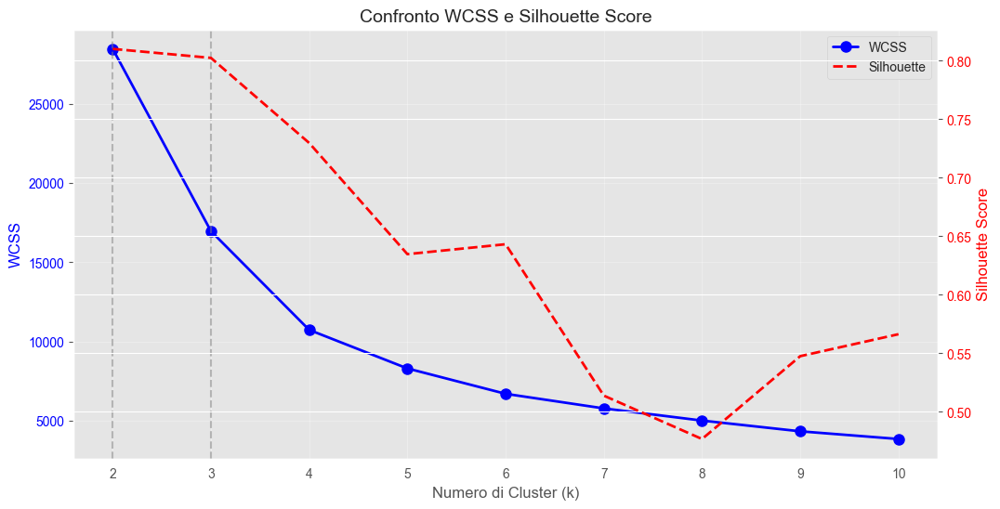

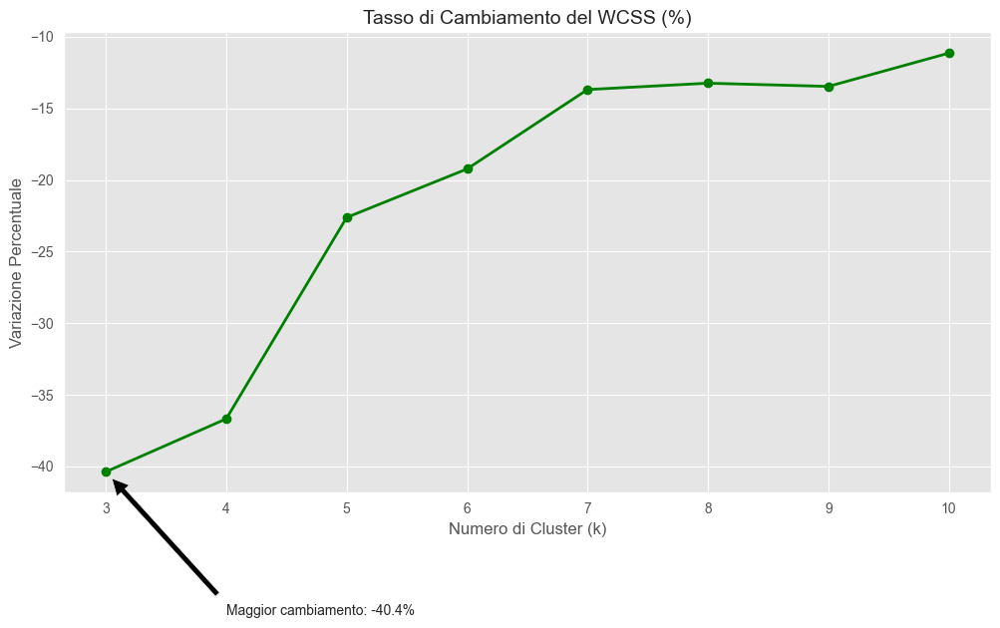

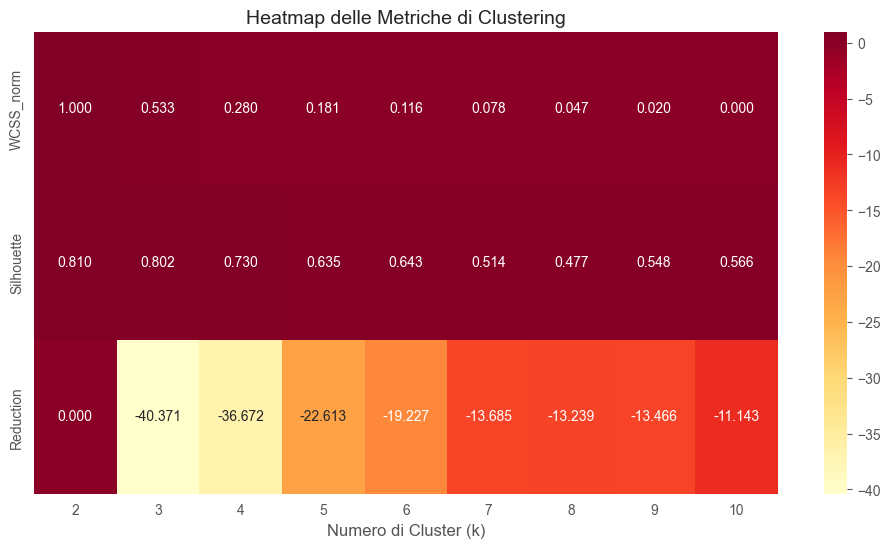


Analisi Dettagliata per k=2,3,4:
---------------------------------

k=2:
WCSS: 28451
Silhouette Score: 0.810

k=3:
WCSS: 16965
Silhouette Score: 0.802
Riduzione WCSS dal cluster precedente: 40.4%

k=4:
WCSS: 10744
Silhouette Score: 0.730
Riduzione WCSS dal cluster precedente: 36.7%


In [66]:
# Convertiamo le liste in array numpy
wcss = np.array(wcss)
silhouette_scores = np.array(silhouette_scores)

# 1. Grafico combinato WCSS e Silhouette
fig, ax1 = plt.subplots(figsize=(12, 6))
ax2 = ax1.twinx()

# Plot WCSS
line1 = ax1.plot(k_range, wcss, 'bo-', linewidth=2, markersize=8, label='WCSS')
ax1.set_xlabel('Numero di Cluster (k)')
ax1.set_ylabel('WCSS', color='b')
ax1.tick_params(axis='y', labelcolor='b')

# Plot Silhouette
line2 = ax2.plot(k_range, silhouette_scores, 'r--', linewidth=2, markersize=8, label='Silhouette')
ax2.set_ylabel('Silhouette Score', color='r')
ax2.tick_params(axis='y', labelcolor='r')

# Aggiungiamo linee verticali per k=2 e k=3
ax1.axvline(x=2, color='gray', linestyle='--', alpha=0.5)
ax1.axvline(x=3, color='gray', linestyle='--', alpha=0.5)

# Combiniamo le legende
lines = line1 + line2
labels = [l.get_label() for l in lines]
ax1.legend(lines, labels, loc='upper right')

plt.title('Confronto WCSS e Silhouette Score', fontsize=14)
ax1.grid(True, alpha=0.3)
plt.show()

# 2. Grafico della derivata del WCSS
plt.figure(figsize=(12, 6))
wcss_changes = np.diff(wcss) / wcss[:-1] * 100
plt.plot(k_range[1:], wcss_changes, 'go-', linewidth=2)
plt.title('Tasso di Cambiamento del WCSS (%)', fontsize=14)
plt.xlabel('Numero di Cluster (k)')
plt.ylabel('Variazione Percentuale')
plt.grid(True)

# Evidenziamo il punto di maggior cambiamento
plt.annotate(f'Maggior cambiamento: {wcss_changes[0]:.1f}%',
             xy=(3, wcss_changes[0]),
             xytext=(4, wcss_changes[0]-10),
             arrowprops=dict(facecolor='black', shrink=0.05))
plt.show()

# 3. Heatmap delle metriche normalizzate
plt.figure(figsize=(12, 6))
metrics_df = pd.DataFrame({
    'WCSS_norm': (wcss - wcss.min()) / (wcss.max() - wcss.min()),
    'Silhouette': silhouette_scores,
    'Reduction': np.pad(wcss_changes, (1,0), 'constant')
}, index=k_range)

sns.heatmap(metrics_df.T, annot=True, cmap='YlOrRd', fmt='.3f')
plt.title('Heatmap delle Metriche di Clustering', fontsize=14)
plt.xlabel('Numero di Cluster (k)')
plt.show()

# Stampa analisi dettagliata
print("\nAnalisi Dettagliata per k=2,3,4:")
print("---------------------------------")
for k in [2,3,4]:
    idx = k-2
    print(f"\nk={k}:")
    print(f"WCSS: {wcss[idx]:.0f}")
    print(f"Silhouette Score: {silhouette_scores[idx]:.3f}")
    if k > 2:
        print(f"Riduzione WCSS dal cluster precedente: {abs(wcss_changes[idx-1]):.1f}%")


Verifica dimensioni:
Dimensione X_pca: (1722, 42)
Dimensione cluster_labels: 1722
Dimensione df_clean: (1722, 43)


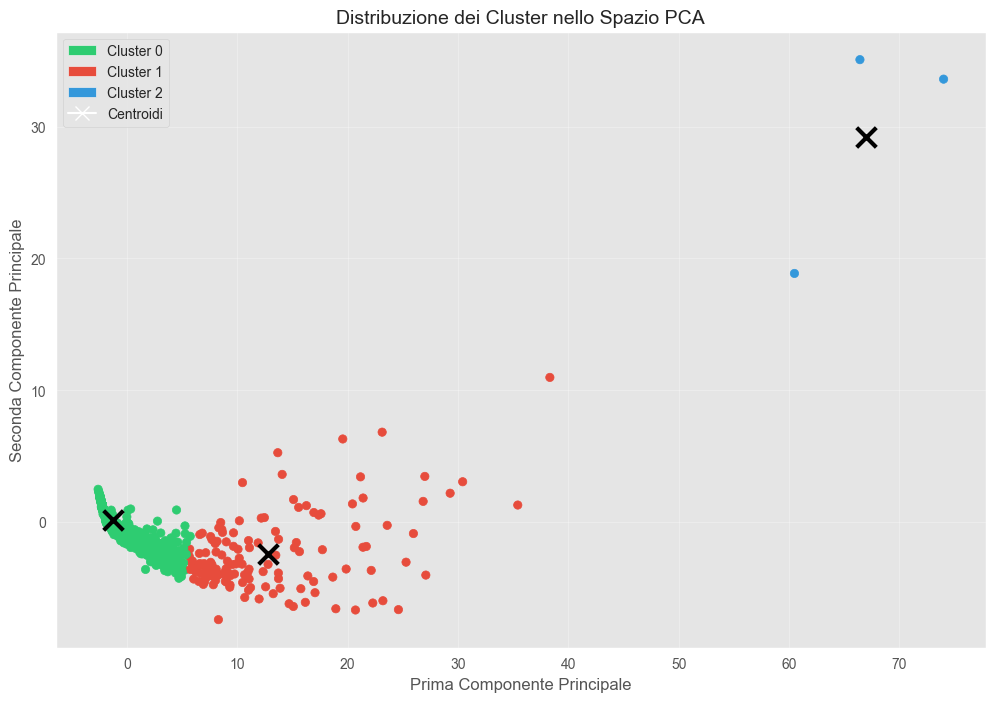

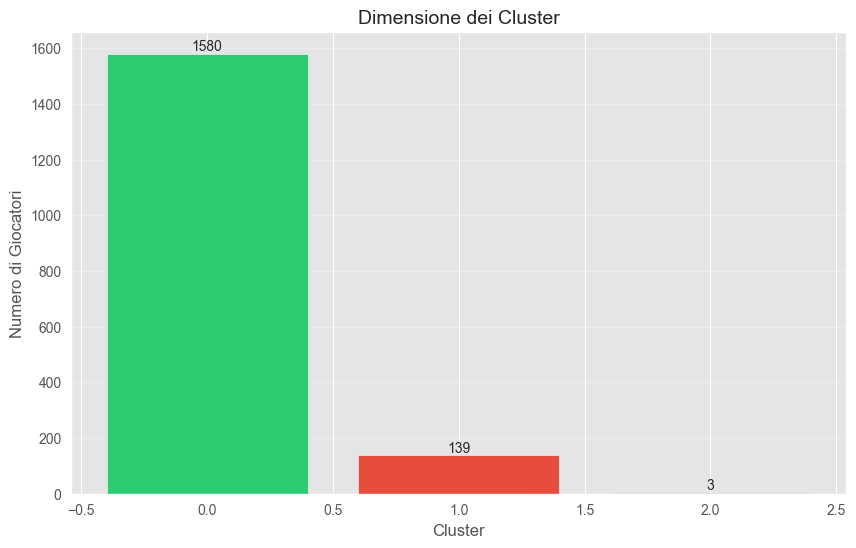

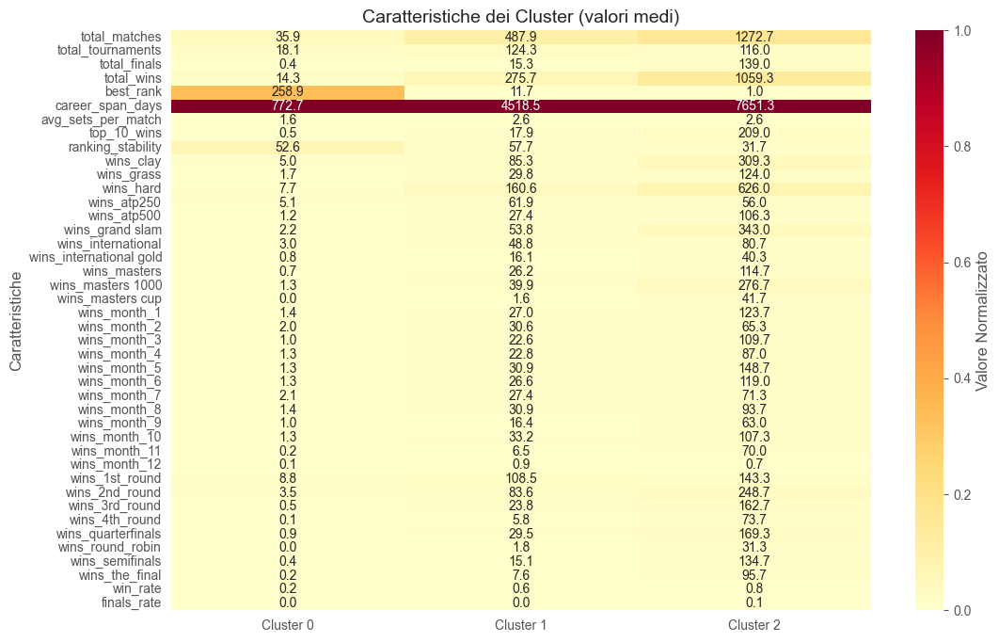

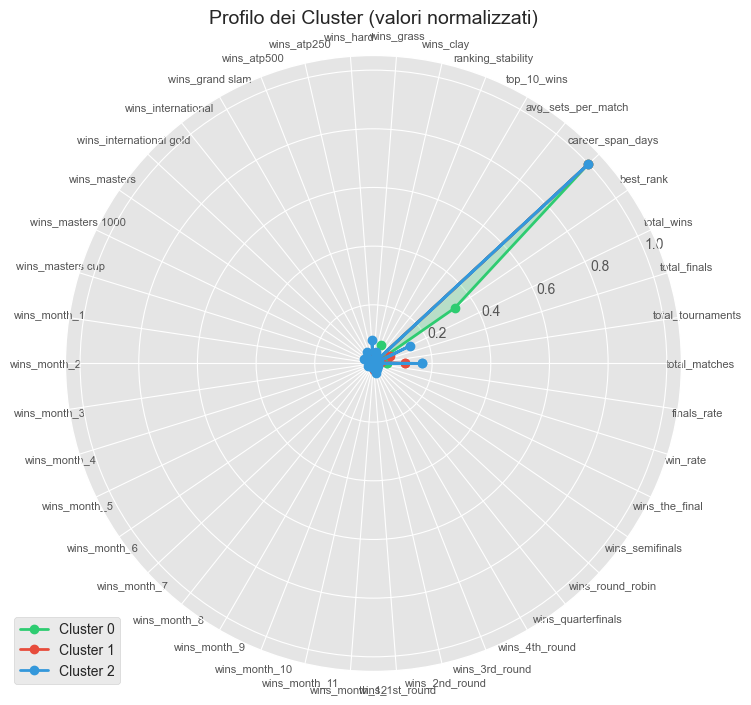

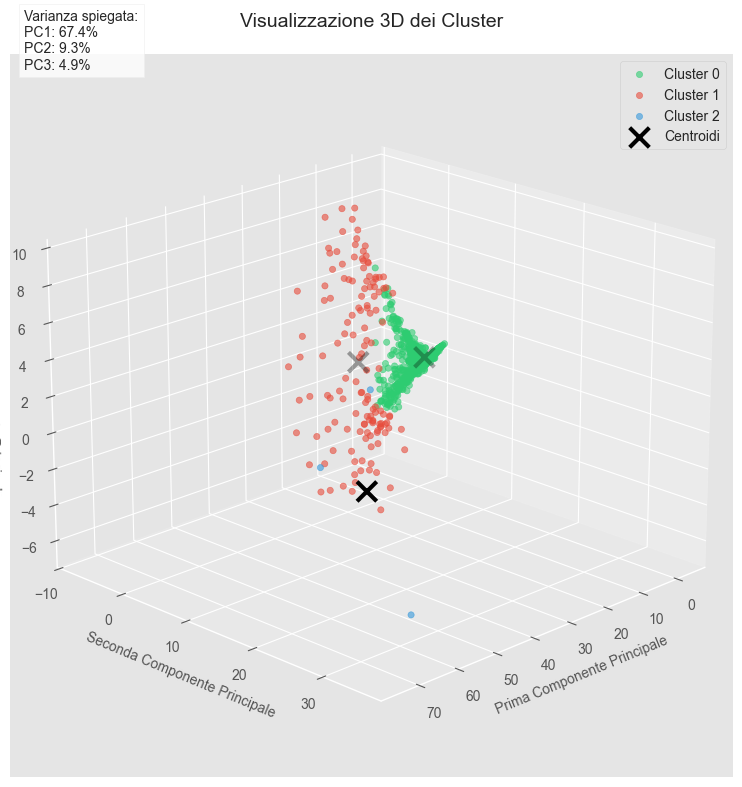


Silhouette score medio: 0.7161


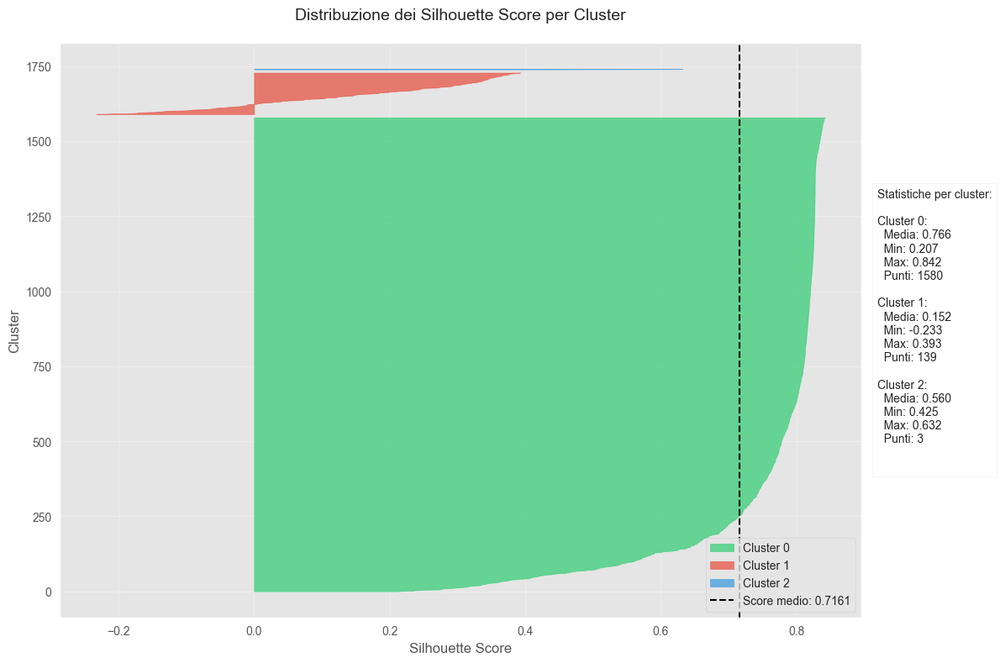

In [67]:
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from matplotlib.patches import Patch
from matplotlib.lines import Line2D
import numpy as np
import seaborn as sns
from mpl_toolkits.mplot3d import Axes3D
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans

# Pulizia e allineamento dei dati
df_clean = df.dropna(subset=features_for_pca)
X = df_clean[features_for_pca]

# Standardizzazione
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Applicazione PCA
pca = PCA()
X_pca = pca.fit_transform(X_scaled)

# Applicazione K-means
k_optimal = 3
kmeans = KMeans(n_clusters=k_optimal, init='k-means++', max_iter=300, n_init=10, random_state=42)
cluster_labels = kmeans.fit_predict(X_pca)

# Verifica dimensioni
print("\nVerifica dimensioni:")
print("Dimensione X_pca:", X_pca.shape)
print("Dimensione cluster_labels:", len(cluster_labels))
print("Dimensione df_clean:", df_clean.shape)

# Definiamo una palette di colori coerente per i cluster
cluster_colors = ['#2ecc71', '#e74c3c', '#3498db']  # verde, rosso, blu
plt.style.use('ggplot')

# 2. Scatter plot dei cluster
plt.figure(figsize=(12, 8))
scatter = plt.scatter(X_pca[:, 0], X_pca[:, 1], c=cluster_labels, 
                     cmap=ListedColormap(cluster_colors))
plt.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], 
           marker='x', s=200, linewidths=3, color='black', label='Centroidi')
plt.title('Distribuzione dei Cluster nello Spazio PCA', fontsize=14)
plt.xlabel('Prima Componente Principale', fontsize=12)
plt.ylabel('Seconda Componente Principale', fontsize=12)

# Legenda personalizzata
legend_elements = [Patch(facecolor=color, label=f'Cluster {i}') 
                  for i, color in enumerate(cluster_colors)]
legend_elements.append(Line2D([0], [0], marker='x', color='w', markerfacecolor='black',
                            markersize=10, label='Centroidi'))
plt.legend(handles=legend_elements)
plt.grid(True, alpha=0.3)
plt.show()

# 3. Grafico a barre delle dimensioni dei cluster
plt.figure(figsize=(10, 6))
cluster_sizes = pd.Series(cluster_labels).value_counts().sort_index()
bars = plt.bar(range(k_optimal), cluster_sizes, color=cluster_colors)
plt.title('Dimensione dei Cluster', fontsize=14)
plt.xlabel('Cluster', fontsize=12)
plt.ylabel('Numero di Giocatori', fontsize=12)

# Etichette sopra le barre
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2., height,
             f'{int(height)}',
             ha='center', va='bottom')
plt.grid(True, axis='y', alpha=0.3)
plt.show()

# 4. Heatmap delle caratteristiche dei cluster
plt.figure(figsize=(12, 8))
cluster_stats = pd.DataFrame()
for i in range(k_optimal):
    cluster_stats[f'Cluster {i}'] = df_clean.loc[cluster_labels == i, features_for_pca].mean()

# Normalizzazione valori
cluster_stats_norm = (cluster_stats - cluster_stats.min()) / (cluster_stats.max() - cluster_stats.min())

# Heatmap
sns.heatmap(cluster_stats_norm, annot=cluster_stats.round(1), fmt='.1f', 
            cmap='YlOrRd', cbar_kws={'label': 'Valore Normalizzato'})
plt.title('Caratteristiche dei Cluster (valori medi)', fontsize=14)
plt.ylabel('Caratteristiche', fontsize=12)
plt.show()

# 5. Grafico radar
fig = plt.figure(figsize=(12, 8))
ax = fig.add_subplot(111, projection='polar')

# Normalizzazione dati
stats_norm = cluster_stats_norm.T

angles = np.linspace(0, 2*np.pi, len(features_for_pca), endpoint=False)
angles = np.concatenate((angles, [angles[0]]))  # Chiusura del cerchio

for i in range(k_optimal):
    values = stats_norm.iloc[i].values
    values = np.concatenate((values, [values[0]]))
    ax.plot(angles, values, 'o-', linewidth=2, color=cluster_colors[i], 
            label=f'Cluster {i}')
    ax.fill(angles, values, alpha=0.25, color=cluster_colors[i])

ax.set_xticks(angles[:-1])
ax.set_xticklabels(features_for_pca, size=8)
ax.set_title('Profilo dei Cluster (valori normalizzati)', fontsize=14)
plt.legend(loc='upper right', bbox_to_anchor=(0.1, 0.1))
plt.show()

# 6. Visualizzazione 3D
fig = plt.figure(figsize=(12, 8))
ax = fig.add_subplot(111, projection='3d')

# Scatter plot 3D per ogni cluster
for i in range(k_optimal):
    cluster_mask = cluster_labels == i
    ax.scatter(X_pca[cluster_mask, 0], 
              X_pca[cluster_mask, 1], 
              X_pca[cluster_mask, 2],
              c=[cluster_colors[i]], 
              label=f'Cluster {i}',
              alpha=0.6)

# Centroidi
centroids = kmeans.cluster_centers_
ax.scatter(centroids[:, 0], centroids[:, 1], centroids[:, 2],
          c='black', marker='x', s=200, linewidth=3, 
          label='Centroidi')

# Personalizzazione grafico 3D
ax.set_title('Visualizzazione 3D dei Cluster', fontsize=14, pad=20)
ax.set_xlabel('Prima Componente Principale', fontsize=10)
ax.set_ylabel('Seconda Componente Principale', fontsize=10)
ax.set_zlabel('Terza Componente Principale', fontsize=10)
ax.legend()
ax.grid(True, alpha=0.3)

# Informazioni varianza spiegata
explained_variance = pca.explained_variance_ratio_[:3]
variance_text = f'Varianza spiegata:\nPC1: {explained_variance[0]:.1%}\nPC2: {explained_variance[1]:.1%}\nPC3: {explained_variance[2]:.1%}'
ax.text2D(0.02, 0.98, variance_text, transform=ax.transAxes, 
          bbox=dict(facecolor='white', alpha=0.8))

ax.view_init(elev=20, azim=45)
plt.tight_layout()
plt.show()

# 7. Analisi Silhouette
from sklearn.metrics import silhouette_samples

# Calcolo Silhouette scores
silhouette_values = silhouette_samples(X_pca, cluster_labels)
silhouette_avg = np.mean(silhouette_values)
print(f"\nSilhouette score medio: {silhouette_avg:.4f}")

# Visualizzazione Silhouette
plt.figure(figsize=(12, 8))
y_lower, y_upper = 0, 0

for i in range(k_optimal):
    cluster_silhouette_values = silhouette_values[cluster_labels == i]
    cluster_silhouette_values.sort()
    y_upper = y_lower + len(cluster_silhouette_values)
    
    plt.fill_betweenx(np.arange(y_lower, y_upper), 
                      0, 
                      cluster_silhouette_values,
                      alpha=0.7,
                      color=cluster_colors[i],
                      label=f"Cluster {i}")
    
    y_lower = y_upper + 10

plt.axvline(x=silhouette_avg, 
            color="black", 
            linestyle="--", 
            label=f"Score medio: {silhouette_avg:.4f}")

plt.title("Distribuzione dei Silhouette Score per Cluster", fontsize=14, pad=20)
plt.xlabel("Silhouette Score", fontsize=12)
plt.ylabel("Cluster", fontsize=12)

# Statistiche dettagliate
stats_text = "Statistiche per cluster:\n\n"
for i in range(k_optimal):
    cluster_scores = silhouette_values[cluster_labels == i]
    stats_text += f"Cluster {i}:\n"
    stats_text += f"  Media: {np.mean(cluster_scores):.3f}\n"
    stats_text += f"  Min: {np.min(cluster_scores):.3f}\n"
    stats_text += f"  Max: {np.max(cluster_scores):.3f}\n"
    stats_text += f"  Punti: {len(cluster_scores)}\n\n"

plt.text(1.02, 0.5, stats_text,
         transform=plt.gca().transAxes,
         bbox=dict(facecolor='white', alpha=0.8),
         verticalalignment='center')

plt.legend(loc='lower right')
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

In [1]:
from mpl_toolkits.mplot3d import Axes3D

# Creiamo il grafico 3D
fig = plt.figure(figsize=(12, 8))
ax = fig.add_subplot(111, projection='3d')

# Definiamo i colori coerenti con i grafici precedenti
cluster_colors = ['#2ecc71', '#e74c3c', '#3498db']  # verde, rosso, blu

# Scatter plot 3D per ogni cluster
for i in range(k_optimal):
    cluster_mask = cluster_labels == i
    ax.scatter(X_pca[cluster_mask, 0], 
              X_pca[cluster_mask, 1], 
              X_pca[cluster_mask, 2],
              c=[cluster_colors[i]], 
              label=f'Cluster {i}',
              alpha=0.6)

# Plot dei centroidi
centroids = kmeans.cluster_centers_
ax.scatter(centroids[:, 0], centroids[:, 1], centroids[:, 2],
          c='black', marker='x', s=200, linewidth=3, 
          label='Centroidi')

# Personalizzazione del grafico
ax.set_title('Visualizzazione 3D dei Cluster', fontsize=14, pad=20)
ax.set_xlabel('Prima Componente Principale', fontsize=10)
ax.set_ylabel('Seconda Componente Principale', fontsize=10)
ax.set_zlabel('Terza Componente Principale', fontsize=10)

# Aggiungiamo la legenda
ax.legend()

# Aggiungiamo una griglia
ax.grid(True, alpha=0.3)

# Aggiungiamo informazioni sulla varianza spiegata
explained_variance = pca.explained_variance_ratio_[:3]
variance_text = f'Varianza spiegata:\nPC1: {explained_variance[0]:.1%}\nPC2: {explained_variance[1]:.1%}\nPC3: {explained_variance[2]:.1%}'
ax.text2D(0.02, 0.98, variance_text, transform=ax.transAxes, 
          bbox=dict(facecolor='white', alpha=0.8))

# Ruotiamo il grafico per una migliore visualizzazione
ax.view_init(elev=20, azim=45)

plt.tight_layout()
plt.show()

# Creiamo anche una versione interattiva con plotly (opzionale)
try:
    import plotly.express as px
    import plotly.graph_objects as go
    
    # Creiamo un DataFrame con le prime 3 componenti principali
    df_3d = pd.DataFrame(
        X_pca[:, :3], 
        columns=['PC1', 'PC2', 'PC3']
    )
    df_3d['Cluster'] = cluster_labels
    
    # Creiamo il grafico 3D interattivo
    fig = go.Figure()
    
    # Aggiungiamo i punti per ogni cluster
    for i in range(k_optimal):
        cluster_data = df_3d[df_3d['Cluster'] == i]
        fig.add_trace(go.Scatter3d(
            x=cluster_data['PC1'],
            y=cluster_data['PC2'],
            z=cluster_data['PC3'],
            mode='markers',
            name=f'Cluster {i}',
            marker=dict(
                size=5,
                color=cluster_colors[i],
                opacity=0.6
            )
        ))
    
    # Aggiungiamo i centroidi
    fig.add_trace(go.Scatter3d(
        x=centroids[:, 0],
        y=centroids[:, 1],
        z=centroids[:, 2],
        mode='markers',
        name='Centroidi',
        marker=dict(
            size=8,
            color='black',
            symbol='x'
        )
    ))
    
    # Personalizziamo il layout
    fig.update_layout(
        title='Visualizzazione 3D Interattiva dei Cluster',
        scene=dict(
            xaxis_title='Prima Componente Principale',
            yaxis_title='Seconda Componente Principale',
            zaxis_title='Terza Componente Principale'
        ),
        legend=dict(
            yanchor="top",
            y=0.99,
            xanchor="left",
            x=0.01
        )
    )
    
    fig.show()
    
except ImportError:
    print("Per la visualizzazione interattiva, installa plotly con: pip install plotly")

The history saving thread hit an unexpected error (DatabaseError('database disk image is malformed')).History will not be written to the database.


NameError: name 'plt' is not defined


Silhouette score medio: 0.6373


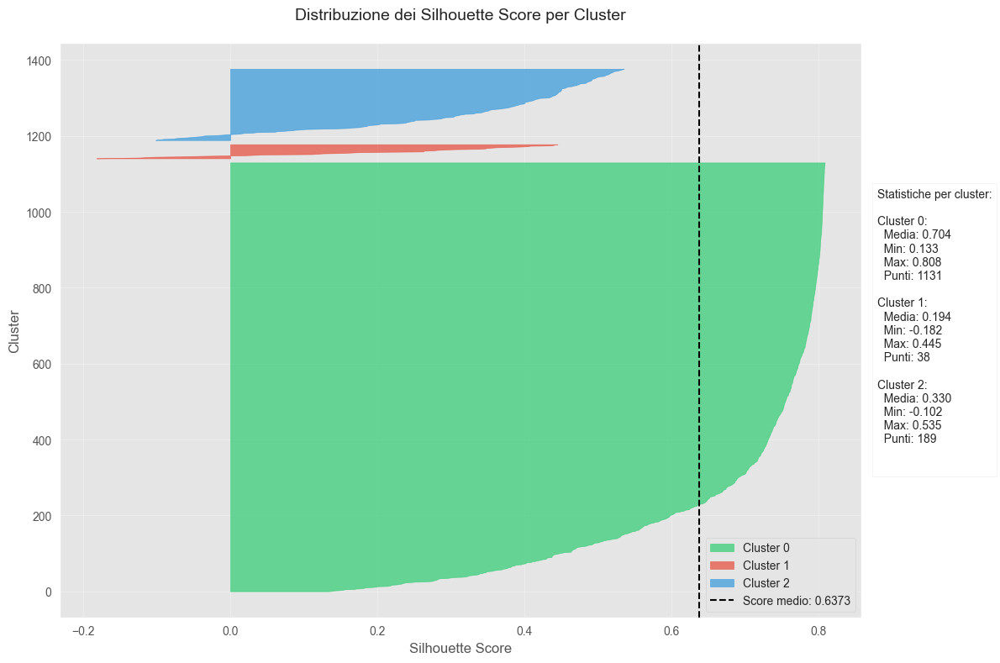


Analisi dettagliata dei Silhouette Score:
--------------------------------------------------

Cluster 0 (Colore: #2ecc71):
  Numero di punti: 1131
  Score medio: 0.704
  Score minimo: 0.133
  Score massimo: 0.808
  Deviazione standard: 0.145

Cluster 1 (Colore: #e74c3c):
  Numero di punti: 38
  Score medio: 0.194
  Score minimo: -0.182
  Score massimo: 0.445
  Deviazione standard: 0.192

Cluster 2 (Colore: #3498db):
  Numero di punti: 189
  Score medio: 0.330
  Score minimo: -0.102
  Score massimo: 0.535
  Deviazione standard: 0.176


In [27]:
from sklearn.metrics import silhouette_samples
import numpy as np
import matplotlib.pyplot as plt

# Calcoliamo i Silhouette scores per ogni punto
silhouette_values = silhouette_samples(X_pca, cluster_labels)

# Calcoliamo lo score medio
silhouette_avg = np.mean(silhouette_values)
print(f"\nSilhouette score medio: {silhouette_avg:.4f}")

# Creiamo il plot per la distribuzione dei Silhouette scores
plt.figure(figsize=(12, 8))

# Per ogni cluster, calcoliamo e plottiamo i Silhouette scores
y_lower, y_upper = 0, 0
for i in range(k_optimal):
    # Prendiamo i Silhouette scores per i punti nel cluster i
    cluster_silhouette_values = silhouette_values[cluster_labels == i]
    
    # Ordiniamo i Silhouette scores
    cluster_silhouette_values.sort()
    
    # Calcoliamo i limiti per ogni cluster
    y_upper = y_lower + len(cluster_silhouette_values)
    
    # Plottiamo i Silhouette scores per il cluster i
    plt.fill_betweenx(np.arange(y_lower, y_upper), 
                      0, 
                      cluster_silhouette_values,
                      alpha=0.7,
                      color=cluster_colors[i],
                      label=f"Cluster {i}")
    
    # Aggiorniamo il limite inferiore per il prossimo cluster
    y_lower = y_upper + 10  # Aggiungiamo un piccolo spazio tra i cluster

# Aggiungiamo una linea verticale per lo score medio
plt.axvline(x=silhouette_avg, 
            color="black", 
            linestyle="--", 
            label=f"Score medio: {silhouette_avg:.4f}")

# Personalizziamo il grafico
plt.title("Distribuzione dei Silhouette Score per Cluster", fontsize=14, pad=20)
plt.xlabel("Silhouette Score", fontsize=12)
plt.ylabel("Cluster", fontsize=12)

# Aggiungiamo statistiche dettagliate in un box
stats_text = "Statistiche per cluster:\n\n"
for i in range(k_optimal):
    cluster_scores = silhouette_values[cluster_labels == i]
    stats_text += f"Cluster {i}:\n"
    stats_text += f"  Media: {np.mean(cluster_scores):.3f}\n"
    stats_text += f"  Min: {np.min(cluster_scores):.3f}\n"
    stats_text += f"  Max: {np.max(cluster_scores):.3f}\n"
    stats_text += f"  Punti: {len(cluster_scores)}\n\n"

plt.text(1.02, 0.5, stats_text,
         transform=plt.gca().transAxes,
         bbox=dict(facecolor='white', alpha=0.8),
         verticalalignment='center')

plt.legend(loc='lower right')
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

# Stampa analisi dettagliata
print("\nAnalisi dettagliata dei Silhouette Score:")
print("-" * 50)
for i in range(k_optimal):
    cluster_scores = silhouette_values[cluster_labels == i]
    print(f"\nCluster {i} (Colore: {cluster_colors[i]}):")
    print(f"  Numero di punti: {len(cluster_scores)}")
    print(f"  Score medio: {np.mean(cluster_scores):.3f}")
    print(f"  Score minimo: {np.min(cluster_scores):.3f}")
    print(f"  Score massimo: {np.max(cluster_scores):.3f}")
    print(f"  Deviazione standard: {np.std(cluster_scores):.3f}")